# LSTM model training

In [198]:
import pandas as pd
import re
from matplotlib import pyplot as plt
import seaborn as sns
import numpy as np
import os # accessing directory structure

#set seed
np.random.seed(12345)

In [199]:
dataset = pd.read_csv('Demo-Output/merge_data.csv', delimiter = "\t")
dataset = dataset.drop(['Unnamed: 0'],axis=1)
dataset['date'] = dataset['date'] + ' ' + dataset['time']
dataset = dataset.drop(['time'],axis=1)
dataset['date'] = pd.to_datetime(dataset['date'])
dataset.set_index('date', inplace=True)
#dataset_finance = dataset.iloc[:,:5].copy()

In [200]:
dataset

,open,close,high,low,volume,sentiment
date,,,,,,
2022-07-01 01:00:00,20275.000000,20289.000000,20308.000000,20273.000000,2.004100,0.198706
2022-07-01 01:01:00,20282.000000,20254.000000,20282.000000,20253.000000,3.668172,0.198706
2022-07-01 01:02:00,20251.000000,20309.814019,20309.814019,20245.060762,1.532124,0.198706
2022-07-01 01:03:00,20313.461178,20319.000000,20371.000000,20313.461178,8.124116,0.198706
2022-07-01 01:04:00,20322.000000,20335.000000,20339.000000,20297.000000,2.313103,0.198706
...,...,...,...,...,...,...
2022-07-30 23:55:00,23647.000000,23628.000000,23649.000000,23612.659134,0.144175,0.209399
2022-07-30 23:56:00,23628.000000,23634.132624,23636.000000,23628.000000,0.243583,0.209399
2022-07-30 23:57:00,23635.000000,23636.000000,23636.000000,23634.132624,0.519763,0.209399


### Check the correlation between the dataset

In [201]:
cor = dataset.corr()
cor

,open,close,high,low,volume,sentiment
open,1.000000,0.999901,0.999940,0.999944,0.028487,-0.104554
close,0.999901,1.000000,0.999950,0.999950,0.029502,-0.104398
high,0.999940,0.999950,1.000000,0.999903,0.032515,-0.104635
low,0.999944,0.999950,0.999903,1.000000,0.025880,-0.104283
volume,0.028487,0.029502,0.032515,0.025880,1.000000,-0.020195
sentiment,-0.104554,-0.104398,-0.104635,-0.104283,-0.020195,1.000000


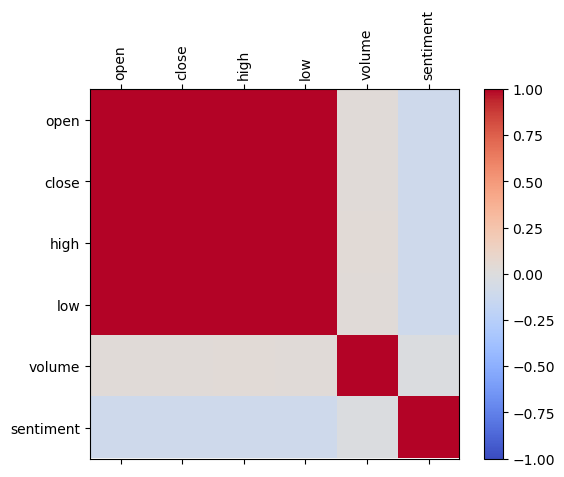

In [202]:
corr = dataset.corr()
fig = plt.figure()
ax = fig.add_subplot(111)
cax = ax.matshow(corr,cmap='coolwarm', vmin=-1, vmax=1)
fig.colorbar(cax)
ticks = np.arange(0,len(dataset.columns),1)
ax.set_xticks(ticks)
plt.xticks(rotation=90)
ax.set_yticks(ticks)
ax.set_xticklabels(dataset.columns)
ax.set_yticklabels(dataset.columns)
plt.show()

### Drop the data that the correlation is too high

In [203]:
dataset_final = dataset[['close', 'sentiment','volume']].copy()
dataset_final.head()

,close,sentiment,volume
date,,,
2022-07-01 01:00:00,20289.000000,0.198706,2.004100
2022-07-01 01:01:00,20254.000000,0.198706,3.668172
2022-07-01 01:02:00,20309.814019,0.198706,1.532124
2022-07-01 01:03:00,20319.000000,0.198706,8.124116
2022-07-01 01:04:00,20335.000000,0.198706,2.313103


In [204]:
cor = dataset_final.corr()
cor

,close,sentiment,volume
close,1.000000,-0.104398,0.029502
sentiment,-0.104398,1.000000,-0.020195
volume,0.029502,-0.020195,1.000000


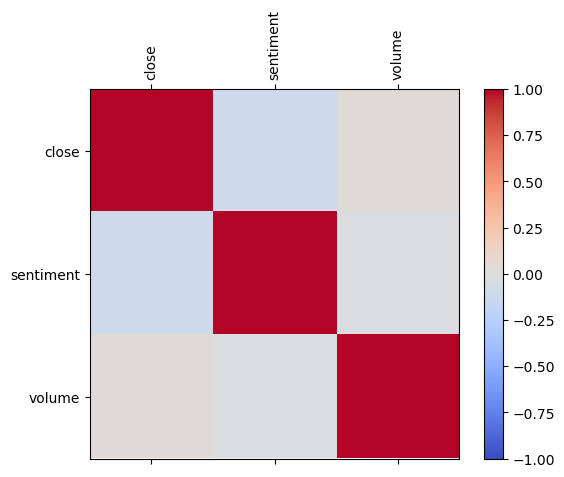

In [205]:
corr = dataset_final.corr()
fig = plt.figure()
ax = fig.add_subplot(111)
cax = ax.matshow(corr,cmap='coolwarm', vmin=-1, vmax=1)
fig.colorbar(cax)
ticks = np.arange(0,len(dataset_final.columns),1)
ax.set_xticks(ticks)
plt.xticks(rotation=90)
ax.set_yticks(ticks)
ax.set_xticklabels(dataset_final.columns)
ax.set_yticklabels(dataset_final.columns)
plt.show()

# Import library for plot chart and Keras model - LSTM

In [206]:
from plotly import tools
import chart_studio.plotly.plotly as py
from plotly.offline import init_notebook_mode, iplot
init_notebook_mode(connected=True)
import plotly.graph_objs as go
import gc

import matplotlib.pyplot as plt
import seaborn as sns

In [207]:
from math import sqrt
from numpy import concatenate
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import mean_squared_error
from matplotlib import pyplot

from pandas import read_csv
from pandas import DataFrame
from pandas import concat
from keras.models import Sequential
from keras.layers import Dense
from keras.layers import LSTM

In this section, we will define a new Python function named series_to_supervised() that takes a univariate or multivariate time series and frames it as a supervised learning dataset.

The function takes four arguments:

##### data: 
Sequence of observations as a list or 2D NumPy array. Required.
##### n_in: 
Number of lag observations as input (X). Values may be between [1..len(data)] Optional. Defaults to 1.
##### n_out: 
Number of observations as output (y). Values may be between [0..len(data)-1]. Optional. Defaults to 1.
##### dropnan: 
Boolean whether or not to drop rows with NaN values. Optional. Defaults to True.
The function returns a single value:

##### return: 
Pandas DataFrame of series framed for supervised learning.

The new dataset is constructed as a DataFrame, with each column suitably named both by variable number and time step. This allows you to design a variety of different time step sequence type forecasting problems from a given univariate or multivariate time series.

Once the DataFrame is returned, you can decide how to split the rows of the returned DataFrame into X and y components for supervised learning any way you wish.

The function is defined with default parameters so that if you call it with just your data, it will construct a DataFrame with t-1 as X and t as y.

In [208]:
# convert series to supervised learning
def series_to_supervised(data, n_in=1, n_out=1, dropnan=True):
    n_vars = 1 if type(data) is list else data.shape[1]
    df = DataFrame(data)
    cols, names = list(), list()
    # input sequence (t-n, ... t-1)
    for i in range(n_in, 0, -1):
        cols.append(df.shift(i))
        names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
    # forecast sequence (t, t+1, ... t+n)
    for i in range(0, n_out):
        cols.append(df.shift(-i))
        if i == 0:
            names += [('var%d(t)' % (j+1)) for j in range(n_vars)]
        else:
            names += [('var%d(t+%d)' % (j+1, i)) for j in range(n_vars)]
    # put it all together
    agg = concat(cols, axis=1)
    agg.columns = names
    # drop rows with NaN values
    if dropnan:
        agg.dropna(inplace=True)
    return agg

### Normalize the dataset

In [209]:
scaler = MinMaxScaler(feature_range=(0, 1))
scaled = scaler.fit_transform(dataset_final.values)

### Plot the graph of Sentiment and Close Market Price

In [212]:
trace1 = go.Scatter(
    x = dataset.index,
    y = scaled_df[:,1].astype(float),
    mode = 'lines',
    line_width=0.5,
    name = 'Sentiment from Twitter'
)

trace2 = go.Scatter(
    x = dataset.index,
    y = scaled_df[:,0].astype(float),
    mode = 'lines',
    name = 'Close'
)

layout = dict(
    title='Historical Bitcoin Sentiment 1-31 July(2022) with the slider',
    xaxis=dict(
        rangeselector=dict(
            buttons=list([
                dict(step='all')
            ])
        ),
        rangeslider=dict(
            visible = True
        ),
        type='date'
    )
)

data = [trace1,trace2]
fig = dict(data=data, layout=layout)
iplot(fig, filename = "Time Series with Rangeslider")

In [88]:
# scaled.shape

### LSTM pre-setup

In [79]:
n_mins = 10 #adding 3 hours lags creating number of observations 
n_features = 3 #Features in the dataset.
n_obs = n_mins*n_features

In [80]:
reframed = series_to_supervised(scaled, n_mins, 1)
reframed

,var1(t-10),var2(t-10),var3(t-10),var1(t-9),var2(t-9),var3(t-9),var1(t-8),var2(t-8),var3(t-8),var1(t-7),...,var3(t-3),var1(t-2),var2(t-2),var3(t-2),var1(t-1),var2(t-1),var3(t-1),var1(t),var2(t),var3(t)
10,0.258496,0.497923,0.002053,0.252489,0.497923,0.003758,0.262069,0.497923,0.001570,0.263646,...,0.011192,0.270340,0.497923,0.000927,0.266294,0.497923,0.004964,0.264161,0.497923,0.004708
11,0.252489,0.497923,0.003758,0.262069,0.497923,0.001570,0.263646,0.497923,0.008324,0.266392,...,0.000927,0.266294,0.497923,0.004964,0.264161,0.497923,0.004708,0.258990,0.497923,0.003720
12,0.262069,0.497923,0.001570,0.263646,0.497923,0.008324,0.266392,0.497923,0.002370,0.277034,...,0.004964,0.264161,0.497923,0.004708,0.258990,0.497923,0.003720,0.257611,0.497923,0.000459
13,0.263646,0.497923,0.008324,0.266392,0.497923,0.002370,0.277034,0.497923,0.008513,0.276519,...,0.004708,0.258990,0.497923,0.003720,0.257611,0.497923,0.000459,0.257295,0.497923,0.000667
14,0.266392,0.497923,0.002370,0.277034,0.497923,0.008513,0.276519,0.497923,0.003640,0.267615,...,0.003720,0.257611,0.497923,0.000459,0.257295,0.497923,0.000667,0.256437,0.497923,0.001889
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
43058,0.828871,0.513839,0.000907,0.827931,0.513839,0.000182,0.831960,0.513839,0.000098,0.827497,...,0.000969,0.835127,0.513839,0.000074,0.835050,0.513839,0.000399,0.831617,0.513839,0.000148
43059,0.827931,0.513839,0.000182,0.831960,0.513839,0.000098,0.827497,0.513839,0.000213,0.827841,...,0.000074,0.835050,0.513839,0.000399,0.831617,0.513839,0.000148,0.832670,0.513839,0.000250
43060,0.831960,0.513839,0.000098,0.827497,0.513839,0.000213,0.827841,0.513839,0.000076,0.827755,...,0.000399,0.831617,0.513839,0.000148,0.832670,0.513839,0.000250,0.832990,0.513839,0.000533
43061,0.827497,0.513839,0.000213,0.827841,0.513839,0.000076,0.827755,0.513839,0.000024,0.832132,...,0.000148,0.832670,0.513839,0.000250,0.832990,0.513839,0.000533,0.833021,0.513839,0.000211


In [16]:
#reframed.to_csv('Demo-Output/reframed.csv', sep='\t')

In [81]:
values = reframed.values
n_train_mins = 28000
train = values[:n_train_mins, :]
test = values[n_train_mins:, :]
train.shape

(28000, 33)

### Split dataset to 66.6% for training and 33.3% for testing

In [82]:
# split into input and outputs
train_X, train_y = train[:, :n_obs], train[:, -n_features]
test_X, test_y = test[:, :n_obs], test[:, -n_features]

In [83]:
train_X.shape

(28000, 30)

### Change the data shape to 3D array

In [84]:
# reshape input to be 3D [samples, timesteps, features]
train_X = train_X.reshape((train_X.shape[0], n_mins, n_features))
test_X = test_X.reshape((test_X.shape[0], n_mins, n_features))
print(train_X.shape, train_y.shape, test_X.shape, test_y.shape)

(28000, 10, 3) (28000,) (15053, 10, 3) (15053,)


In [85]:
from keras.callbacks import EarlyStopping,ModelCheckpoint
from keras.layers.core import Dense, Dropout, Activation
import time
import tensorflow as tf 

### Model Structure

In [196]:
# LSTM MODEL
model=Sequential()
model.add(LSTM(50,return_sequences=True,input_shape=(train_X.shape[1], train_X.shape[2])))
model.add(Dropout(0.2))
model.add(LSTM(50,return_sequences=True))
model.add(Dropout(0.2))
model.add(LSTM(50))
model.add(Dense(1))
model.compile(loss='mean_squared_error', optimizer='adam', metrics=['mean_squared_error'])
model.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_9 (LSTM)               (None, 10, 50)            10800     
                                                                 
 dropout_6 (Dropout)         (None, 10, 50)            0         
                                                                 
 lstm_10 (LSTM)              (None, 10, 50)            20200     
                                                                 
 dropout_7 (Dropout)         (None, 10, 50)            0         
                                                                 
 lstm_11 (LSTM)              (None, 50)                20200     
                                                                 
 dense_3 (Dense)             (None, 1)                 51        
                                                                 
Total params: 51,251
Trainable params: 51,251
Non-trai

In [87]:
# design network
#model = Sequential()
#model.add(LSTM(5, input_shape=(train_X.shape[1], train_X.shape[2])))
#model.add(Dense(1))
#model.compile(loss='mae', optimizer='adam')
# fit network

es = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience=100, min_delta=1e-3)
mc = ModelCheckpoint('lstm-bitcoin-prices-best-model.h5', monitor='val_loss', mode='min', verbose=1, save_best_only=True)

start = time.time()

with tf.device('/device:GPU:0'):
    history = model.fit(train_X, 
            train_y, 
            epochs=1000,
            batch_size=16,
            validation_data=(test_X, test_y),
            verbose=2,
            shuffle=False,
            validation_split=0.2,
            use_multiprocessing=True,
            callbacks=[es, mc])
    print("Training completed")

print(f'training time: {time.time() - start}')
    # plot history

Epoch 1/1000


2022-09-06 00:07:07.682627: W tensorflow/core/platform/profile_utils/cpu_utils.cc:128] Failed to get CPU frequency: 0 Hz
2022-09-06 00:07:09.106185: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2022-09-06 00:07:09.330479: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2022-09-06 00:07:09.404509: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2022-09-06 00:07:09.436555: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2022-09-06 00:07:09.486705: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2022-09-06 00:07:09.641294: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113


Epoch 1: val_loss improved from inf to 0.06357, saving model to lstm-bitcoin-prices-best-model.h5
1750/1750 - 27s - loss: 0.0011 - mean_squared_error: 0.0011 - val_loss: 0.0636 - val_mean_squared_error: 0.0636 - 27s/epoch - 15ms/step
Epoch 2/1000

Epoch 2: val_loss improved from 0.06357 to 0.04988, saving model to lstm-bitcoin-prices-best-model.h5
1750/1750 - 25s - loss: 0.0021 - mean_squared_error: 0.0021 - val_loss: 0.0499 - val_mean_squared_error: 0.0499 - 25s/epoch - 14ms/step
Epoch 3/1000

Epoch 3: val_loss improved from 0.04988 to 0.04543, saving model to lstm-bitcoin-prices-best-model.h5
1750/1750 - 25s - loss: 0.0027 - mean_squared_error: 0.0027 - val_loss: 0.0454 - val_mean_squared_error: 0.0454 - 25s/epoch - 14ms/step
Epoch 4/1000

Epoch 4: val_loss improved from 0.04543 to 0.04109, saving model to lstm-bitcoin-prices-best-model.h5
1750/1750 - 25s - loss: 0.0033 - mean_squared_error: 0.0033 - val_loss: 0.0411 - val_mean_squared_error: 0.0411 - 25s/epoch - 14ms/step
Epoch 5/1

Epoch 35/1000

Epoch 35: val_loss did not improve from 0.00366
1750/1750 - 52s - loss: 9.0739e-05 - mean_squared_error: 9.0739e-05 - val_loss: 0.0059 - val_mean_squared_error: 0.0059 - 52s/epoch - 30ms/step
Epoch 36/1000

Epoch 36: val_loss improved from 0.00366 to 0.00361, saving model to lstm-bitcoin-prices-best-model.h5
1750/1750 - 47s - loss: 8.7026e-05 - mean_squared_error: 8.7026e-05 - val_loss: 0.0036 - val_mean_squared_error: 0.0036 - 47s/epoch - 27ms/step
Epoch 37/1000

Epoch 37: val_loss did not improve from 0.00361
1750/1750 - 50s - loss: 8.7368e-05 - mean_squared_error: 8.7368e-05 - val_loss: 0.0057 - val_mean_squared_error: 0.0057 - 50s/epoch - 29ms/step
Epoch 38/1000

Epoch 38: val_loss improved from 0.00361 to 0.00357, saving model to lstm-bitcoin-prices-best-model.h5
1750/1750 - 49s - loss: 8.4143e-05 - mean_squared_error: 8.4143e-05 - val_loss: 0.0036 - val_mean_squared_error: 0.0036 - 49s/epoch - 28ms/step
Epoch 39/1000

Epoch 39: val_loss did not improve from 0.00357

Epoch 70/1000

Epoch 70: val_loss improved from 0.00279 to 0.00273, saving model to lstm-bitcoin-prices-best-model.h5
1750/1750 - 26s - loss: 6.2629e-05 - mean_squared_error: 6.2629e-05 - val_loss: 0.0027 - val_mean_squared_error: 0.0027 - 26s/epoch - 15ms/step
Epoch 71/1000

Epoch 71: val_loss improved from 0.00273 to 0.00270, saving model to lstm-bitcoin-prices-best-model.h5
1750/1750 - 26s - loss: 6.2158e-05 - mean_squared_error: 6.2158e-05 - val_loss: 0.0027 - val_mean_squared_error: 0.0027 - 26s/epoch - 15ms/step
Epoch 72/1000

Epoch 72: val_loss improved from 0.00270 to 0.00266, saving model to lstm-bitcoin-prices-best-model.h5
1750/1750 - 26s - loss: 6.1841e-05 - mean_squared_error: 6.1841e-05 - val_loss: 0.0027 - val_mean_squared_error: 0.0027 - 26s/epoch - 15ms/step
Epoch 73/1000

Epoch 73: val_loss improved from 0.00266 to 0.00261, saving model to lstm-bitcoin-prices-best-model.h5
1750/1750 - 28s - loss: 6.1403e-05 - mean_squared_error: 6.1403e-05 - val_loss: 0.0026 - val_mea

Epoch 104/1000

Epoch 104: val_loss did not improve from 0.00173
1750/1750 - 32s - loss: 5.2490e-05 - mean_squared_error: 5.2490e-05 - val_loss: 0.0018 - val_mean_squared_error: 0.0018 - 32s/epoch - 18ms/step
Epoch 105/1000

Epoch 105: val_loss improved from 0.00173 to 0.00170, saving model to lstm-bitcoin-prices-best-model.h5
1750/1750 - 33s - loss: 5.1852e-05 - mean_squared_error: 5.1852e-05 - val_loss: 0.0017 - val_mean_squared_error: 0.0017 - 33s/epoch - 19ms/step
Epoch 106/1000

Epoch 106: val_loss did not improve from 0.00170
1750/1750 - 34s - loss: 5.2025e-05 - mean_squared_error: 5.2025e-05 - val_loss: 0.0017 - val_mean_squared_error: 0.0017 - 34s/epoch - 19ms/step
Epoch 107/1000

Epoch 107: val_loss improved from 0.00170 to 0.00166, saving model to lstm-bitcoin-prices-best-model.h5
1750/1750 - 34s - loss: 5.1362e-05 - mean_squared_error: 5.1362e-05 - val_loss: 0.0017 - val_mean_squared_error: 0.0017 - 34s/epoch - 20ms/step
Epoch 108/1000

Epoch 108: val_loss did not improve fr

Epoch 139/1000

Epoch 139: val_loss did not improve from 0.00075
1750/1750 - 60s - loss: 4.5568e-05 - mean_squared_error: 4.5568e-05 - val_loss: 7.8071e-04 - val_mean_squared_error: 7.8071e-04 - 60s/epoch - 34ms/step
Epoch 140/1000

Epoch 140: val_loss did not improve from 0.00075
1750/1750 - 61s - loss: 4.5794e-05 - mean_squared_error: 4.5794e-05 - val_loss: 0.0014 - val_mean_squared_error: 0.0014 - 61s/epoch - 35ms/step
Epoch 141/1000

Epoch 141: val_loss did not improve from 0.00075
1750/1750 - 59s - loss: 4.5366e-05 - mean_squared_error: 4.5366e-05 - val_loss: 8.0942e-04 - val_mean_squared_error: 8.0942e-04 - 59s/epoch - 33ms/step
Epoch 142/1000

Epoch 142: val_loss did not improve from 0.00075
1750/1750 - 59s - loss: 4.5412e-05 - mean_squared_error: 4.5412e-05 - val_loss: 0.0014 - val_mean_squared_error: 0.0014 - 59s/epoch - 33ms/step
Epoch 143/1000

Epoch 143: val_loss did not improve from 0.00075
1750/1750 - 59s - loss: 4.5172e-05 - mean_squared_error: 4.5172e-05 - val_loss: 8.4

Epoch 178/1000

Epoch 178: val_loss did not improve from 0.00075
1750/1750 - 400s - loss: 4.0888e-05 - mean_squared_error: 4.0888e-05 - val_loss: 0.0012 - val_mean_squared_error: 0.0012 - 400s/epoch - 228ms/step
Epoch 179/1000

Epoch 179: val_loss did not improve from 0.00075
1750/1750 - 24s - loss: 4.1089e-05 - mean_squared_error: 4.1089e-05 - val_loss: 0.0012 - val_mean_squared_error: 0.0012 - 24s/epoch - 14ms/step
Epoch 180/1000

Epoch 180: val_loss did not improve from 0.00075
1750/1750 - 25s - loss: 4.0651e-05 - mean_squared_error: 4.0651e-05 - val_loss: 0.0012 - val_mean_squared_error: 0.0012 - 25s/epoch - 14ms/step
Epoch 181/1000

Epoch 181: val_loss did not improve from 0.00075
1750/1750 - 25s - loss: 4.0869e-05 - mean_squared_error: 4.0869e-05 - val_loss: 0.0012 - val_mean_squared_error: 0.0012 - 25s/epoch - 14ms/step
Epoch 182/1000

Epoch 182: val_loss did not improve from 0.00075
1750/1750 - 26s - loss: 4.0418e-05 - mean_squared_error: 4.0418e-05 - val_loss: 0.0012 - val_mea


Epoch 217: val_loss did not improve from 0.00075
1750/1750 - 31s - loss: 3.8862e-05 - mean_squared_error: 3.8862e-05 - val_loss: 9.3674e-04 - val_mean_squared_error: 9.3674e-04 - 31s/epoch - 18ms/step
Epoch 218/1000

Epoch 218: val_loss did not improve from 0.00075
1750/1750 - 31s - loss: 3.6665e-05 - mean_squared_error: 3.6665e-05 - val_loss: 8.9909e-04 - val_mean_squared_error: 8.9909e-04 - 31s/epoch - 18ms/step
Epoch 219/1000

Epoch 219: val_loss did not improve from 0.00075
1750/1750 - 32s - loss: 3.5788e-05 - mean_squared_error: 3.5788e-05 - val_loss: 9.4099e-04 - val_mean_squared_error: 9.4099e-04 - 32s/epoch - 18ms/step
Epoch 219: early stopping
Training completed
training time: 11837.179526090622


### Save Model

In [174]:
# save trained model
model.save("Model/lstm-bitcoin-prices-model.h5")
print("lstm-bitcoin-prices-model.h5 saved model to disk in ", os.getcwd())

# save on google drive
#model.save("Model/lstm-bitcoin-prices-model.h5")

# save best model 
!cp "lstm-bitcoin-prices-best-model.h5" "Model/"

lstm-bitcoin-prices-model.h5 saved model to disk in  /Users/jaspercheng/Desktop/Final_Dissertation


### Plot MSE change within Epoch

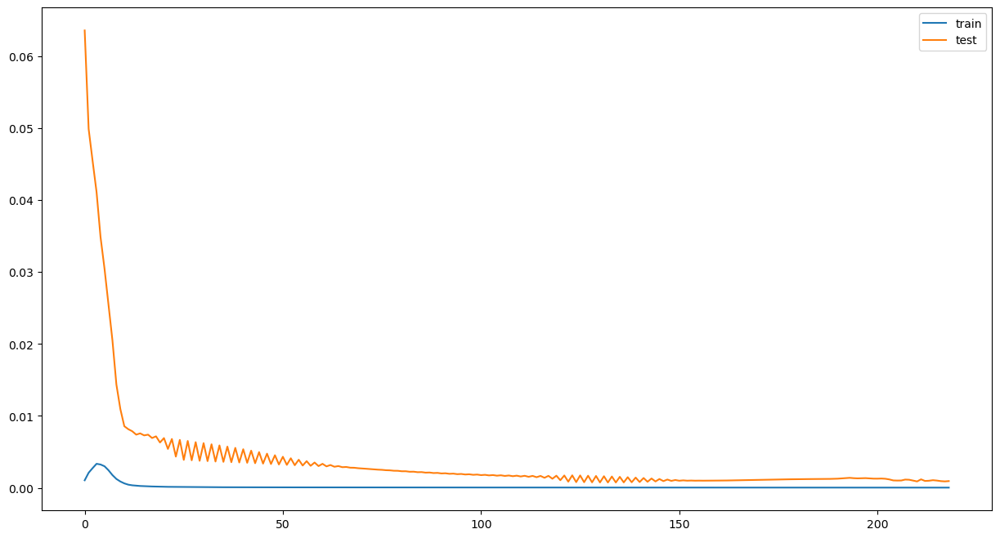

In [164]:
plt.figure(figsize=(15, 8))
plt.plot(history.history['loss'], label='train')
plt.plot(history.history['val_loss'], label='test')
plt.legend()
plt.show()

In [ ]:
# fit model
# model.fit(train_X,train_y)

### Plot Comparison Graph between Predicted Price and Actual Price  

In [176]:
# make a prediction
predict_train_y = model.predict(train_X)
y_hat_train = predict_train_y.reshape(predict_train_y.shape[0],1)
print(y_hat_train.shape)

875/875 [==============================] - 5s 5ms/step
(28000, 1)


In [192]:
# invert scaling for forecast
inv_yhat = concatenate((y_hat_train, values[:n_train_mins, 1:3]), axis=1)
inv_yhat = scaler.inverse_transform(inv_yhat)
train_predict = inv_yhat

In [193]:
# invert scaling for actual
train_y_2 = train_y.reshape((len(train_y), 1))
inv_y = concatenate((train_y_2, values[:n_train_mins, 1:3]), axis=1)
inv_y = scaler.inverse_transform(inv_y)
inv_y = inv_y[:,0]

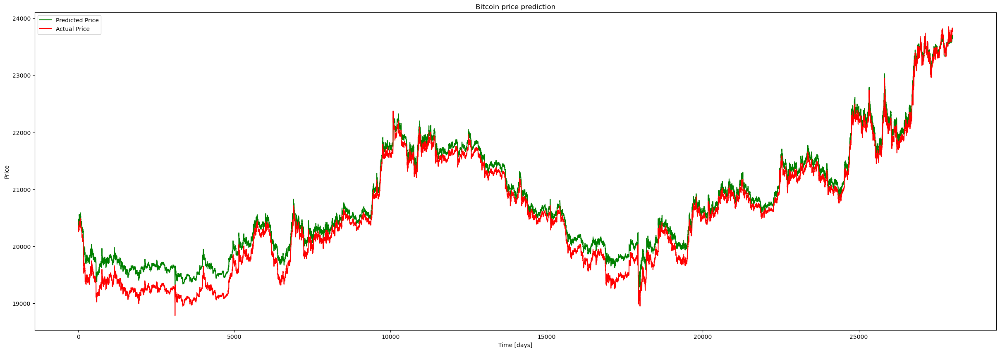

In [185]:
plt.figure(figsize=(30, 10))
 
plt.plot(train_predict[:,0], label="Predicted Price", color='green')
plt.plot(inv_y, label="Actual Price", color='red')


plt.title('Bitcoin price prediction')
plt.xlabel('Time [days]')
plt.ylabel('Price')
plt.legend(loc='best')

plt.show();

In [194]:
rmse_train = sqrt(mean_squared_error(inv_y, train_predict[:,0]))

In [ ]:
# full_X = np.concatenate((train_X,test_X), axis=0, out=None, dtype=None, casting="same_kind")

In [ ]:
# full_X.shape

In [187]:
# make a prediction
predict_test_y = model.predict(test_X)
yhat = predict_test_y.reshape(predict_test_y.shape[0],1)
print(yhat.shape)
# invert scaling for forecast
inv_yhat = concatenate((yhat, values[n_train_mins:, 1:3]), axis=1)
inv_yhat = scaler.inverse_transform(inv_yhat)
test_predict = inv_yhat

# invert scaling for actual
test_y_2 = test_y.reshape((len(test_y), 1))
inv_y = concatenate((test_y_2, values[n_train_mins:, 1:3]), axis=1)
inv_y = scaler.inverse_transform(inv_y)
inv_y = inv_y[:,0]

471/471 [==============================] - 2s 5ms/step
(15053, 1)


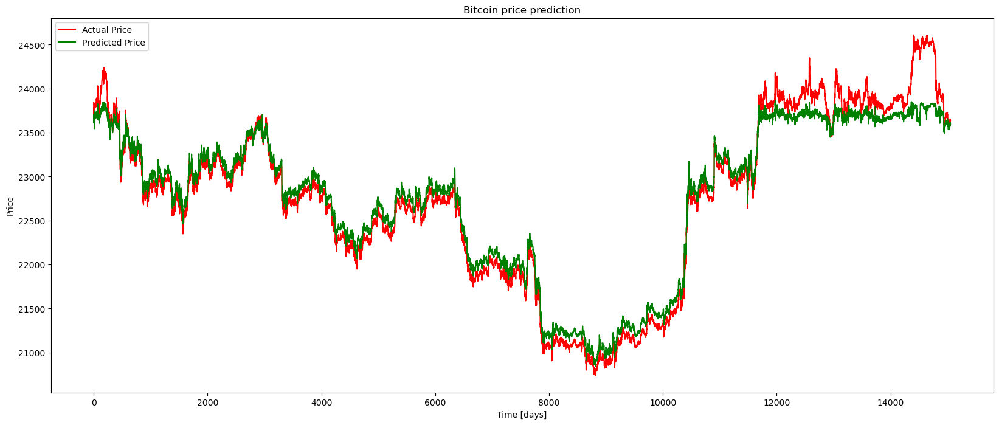

In [188]:
plt.figure(figsize=(20, 8))
plt.plot(inv_y, label="Actual Price", color='red')
plt.plot(test_predict[:,0], label="Predicted Price", color='green')
 
plt.title('Bitcoin price prediction')
plt.xlabel('Time [days]')
plt.ylabel('Price')
plt.legend(loc='best')
 
plt.show();

In [189]:
rmse_test = sqrt(mean_squared_error(inv_y, test_predict[:,0]))

RMSE train: 178.71582365624053


In [171]:
import math
from sklearn.metrics import mean_squared_error

In [49]:
# pip install chart_studio

In [109]:
from plotly import tools
import chart_studio.plotly.plotly as py
from plotly.offline import init_notebook_mode, iplot
init_notebook_mode(connected=True)
import plotly.graph_objs as go
import gc

In [110]:
train_predict_plot = train_predict[:,0].reshape(train_predict.shape[0],1)
test_predict_plot = test_predict[:,0].reshape(test_predict.shape[0],1)

In [111]:
look_back = 4
trainPredictPlot = np.empty_like(dataset[['close']])
trainPredictPlot[:, :] = np.nan
print(trainPredictPlot[look_back:len(predict_train_y)+look_back, :].shape)
trainPredictPlot[look_back:len(predict_train_y)+look_back, :] = train_predict_plot
# shift test predictions for plotting
testPredictPlot = np.empty_like(dataset[['close']])
testPredictPlot[:, :] = np.nan
testPredictPlot[len(train_predict)+(look_back*2)+1:len(dataset[['close']])-1, :] = test_predict_plot

(28000, 1)


In [112]:
df = pd.DataFrame({'Train': trainPredictPlot[:,0], 'Test': testPredictPlot[:,0]}, columns=['Train', 'Test'])

In [113]:
df.index = dataset.index.copy()

In [114]:
df

,Train,Test
date,,
2022-07-01 01:00:00,NaN,NaN
2022-07-01 01:01:00,NaN,NaN
2022-07-01 01:02:00,NaN,NaN
2022-07-01 01:03:00,NaN,NaN
2022-07-01 01:04:00,20456.416998,NaN
...,...,...
2022-07-30 23:55:00,NaN,23580.490361
2022-07-30 23:56:00,NaN,23587.361529
2022-07-30 23:57:00,NaN,23592.553016


In [214]:
trace1 = go.Scatter(
    x = df.index,
    y = df.iloc[:,0].astype(float),
    mode = 'lines',
    name = 'train Predict'
)

trace2 = go.Scatter(
    x = df.index,
    y = df.iloc[:,1].astype(float),
    mode = 'lines',
    name = 'test Predict'
)

trace3 = go.Scatter(
    x = df.index,
    y = dataset_final.iloc[:,0].astype(float),
    mode = 'lines',
    name = 'Real Value'
)


layout = dict(
    title='Prediction Table with sentiment',
    xaxis=dict(
        rangeselector=dict(
            buttons=list([
                dict(step='all')
            ])
        ),
        rangeslider=dict(
            visible = True
        ),
        type='date'
    )
)

data = [trace3,trace2,trace1]
fig = dict(data=data, layout=layout)
iplot(fig, filename = "Time Series with Rangeslider")

In [116]:
test_predict.shape

(15053, 3)

### Result

In [195]:
print(f'RMSE train: {rmse_train}')
print(f'RMSE test: {rmse_test}')

RMSE train: 213.07136793126304
RMSE test: 178.71582365624053


# Double-Check the saved model

### Load the model from file

In [118]:
import numpy as np

# if your model is saved as only a .h5 file
MODEL_LOCATION ='Model/lstm-bitcoin-prices-model.h5'

# or if your model is saved as 2 files: model as a .json file, and weights as a .h5 file
JSON_LOCATION = ''
WEIGHTS_LOCATION = ''

In [119]:
if MODEL_LOCATION!='': #if your model is saved as a .h5 file only
    from keras.models import load_model
    model = load_model(MODEL_LOCATION) #load the model
    print("loaded model from MODEL_LOCATION")
    
elif JSON_LOCATION!='': # you have your model saved as a JSON file AND weights
#adapted from https://machinelearningmastery.com/save-load-keras-deep-learning-models/
    from keras.models import model_from_json
    json_file = open(JSON_LOCATION, 'r')
    loaded_model_json = json_file.read()
    json_file.close()
    
    model = model_from_json(loaded_model_json)
    # load weights into new model
    model.load_weights(WEIGHTS_LOCATION)
    print("loaded model from JSON_LOCATION and WEIGHTS_LOCATION")

loaded model from MODEL_LOCATION


### Predict the value by previous data

In [120]:
yhatest = model.predict(test_X)
yhatrain = model.predict(train_X)

  1/471 [..............................] - ETA: 3:56

2022-09-06 08:30:34.438183: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2022-09-06 08:30:34.522363: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2022-09-06 08:30:34.560733: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2022-09-06 08:30:34.588062: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


875/875 [==============================] - 5s 5ms/step


### Result

In [152]:
print('RMSE Train: ', math.sqrt(mean_squared_error(train_y,yhatrain)))
### Test Data RMSE
print('RMSE Test: ', math.sqrt(mean_squared_error(test_y,yhatest)))

RMSE Train:  0.03657249707024771
RMSE Test:  0.03067556190460724
